<a href="https://colab.research.google.com/github/OmarMachuca851/Task/blob/main/keras_pytorch.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Keras and Pytorch

## Problema 1: Compartir y ejecutar el modelo de tutorial oficial

In [7]:
# TensorFlow and tf.keras
import tensorflow as tf

# Helper libraries
import numpy as np
import matplotlib.pyplot as plt

print(tf.__version__)

fashion_mnist = tf.keras.datasets.fashion_mnist

(train_images, train_labels), (test_images, test_labels) = fashion_mnist.load_data()

train_images = train_images/255.0
test_images = test_images/255.0

# buiding model
model = tf.keras.Sequential([
    tf.keras.layers.Flatten(input_shape=(28, 28)),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dense(10)
])

# compiling model
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

# fit
model.fit(train_images, train_labels, epochs=5, validation_split=0.1)

# Evaluating
test_loss, test_acc = model.evaluate(test_images,  test_labels, verbose=2)

2.19.0
29515/29515 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
26421880/26421880 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
5148/5148 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
4422102/4422102 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


/usr/local/lib/python3.12/dist-packages/keras/src/layers/reshaping/flatten.py:37: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/5
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 8s 4ms/step - accuracy: 0.7757 - loss: 0.6519 - val_accuracy: 0.8550 - val_loss: 0.4080
Epoch 2/5
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 11s 4ms/step - accuracy: 0.8597 - loss: 0.3922 - val_accuracy: 0.8623 - val_loss: 0.3709
Epoch 3/5
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.8758 - loss: 0.3436 - val_accuracy: 0.8687 - val_loss: 0.3512
Epoch 4/5
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.8886 - loss: 0.3129 - val_accuracy: 0.8808 - val_loss: 0.3397
Epoch 5/5
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.8917 - loss: 0.2950 - val_accuracy: 0.8803 - val_loss: 0.3386
313/313 - 1s - 2ms/step - accuracy: 0.8729 - loss: 0.3593


## Priblema 2: Aplicación de diferentes métodos.

In [ ]:
import os
import pathlib


if "models" in pathlib.Path.cwd().parts:
  while "models" in pathlib.Path.cwd().parts:
    os.chdir('..')

In [ ]:
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import zipfile

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image
from IPython.display import display

In [ ]:
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

In [ ]:
# patch tf1 into `utils.ops`
utils_ops.tf = tf.compat.v1

# Patch the location of gfile
tf.gfile = tf.io.gfile

In [ ]:
def load_model(model_name):
  base_url = 'http://download.tensorflow.org/models/object_detection/'
  model_file = model_name + '.tar.gz'
  model_dir = tf.keras.utils.get_file(
    fname=model_name,
    origin=base_url + model_file,
    untar=True)


  model_dir = pathlib.Path(model_dir)/f"{model_name}/saved_model"

  print(model_dir)
  model = tf.saved_model.load(str(model_dir))

  return model

In [ ]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [ ]:
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = pathlib.Path('object_detection/test_images')
TEST_IMAGE_PATHS = sorted(list(PATH_TO_TEST_IMAGES_DIR.glob("*.jpg")))
TEST_IMAGE_PATHS

[WindowsPath('object_detection/test_images/image1.jpg'),
 WindowsPath('object_detection/test_images/image2.jpg'),
 WindowsPath('object_detection/test_images/image3.jpg')]

In [ ]:
model_name = 'ssd_mobilenet_v1_coco_2017_11_17'
detection_model = load_model(model_name)

C:\Users\OMC\.keras\datasets\ssd_mobilenet_v1_coco_2017_11_17\ssd_mobilenet_v1_coco_2017_11_17\saved_model
INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [ ]:
print(detection_model.signatures['serving_default'].inputs)

[<tf.Tensor 'image_tensor:0' shape=(None, None, None, 3) dtype=uint8>]


In [ ]:
detection_model.signatures['serving_default'].output_dtypes

{'detection_scores': tf.float32,
 'detection_classes': tf.float32,
 'num_detections': tf.float32,
 'detection_boxes': tf.float32}

In [ ]:
detection_model.signatures['serving_default'].output_shapes

{'detection_scores': TensorShape([None, 100]),
 'detection_classes': TensorShape([None, 100]),
 'num_detections': TensorShape([None]),
 'detection_boxes': TensorShape([None, 100, 4])}

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy()
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)

  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.5,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()

  return output_dict

In [ ]:
def show_inference(model, image_path):
  # the array based representation of the image will be used later in order to prepare the
  # result image with boxes and labels on it.
  image_np = np.array(Image.open(image_path))
  # Actual detection.
  output_dict = run_inference_for_single_image(model, image_np)
  # Visualization of the results of a detection.
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)

  display(Image.fromarray(image_np))

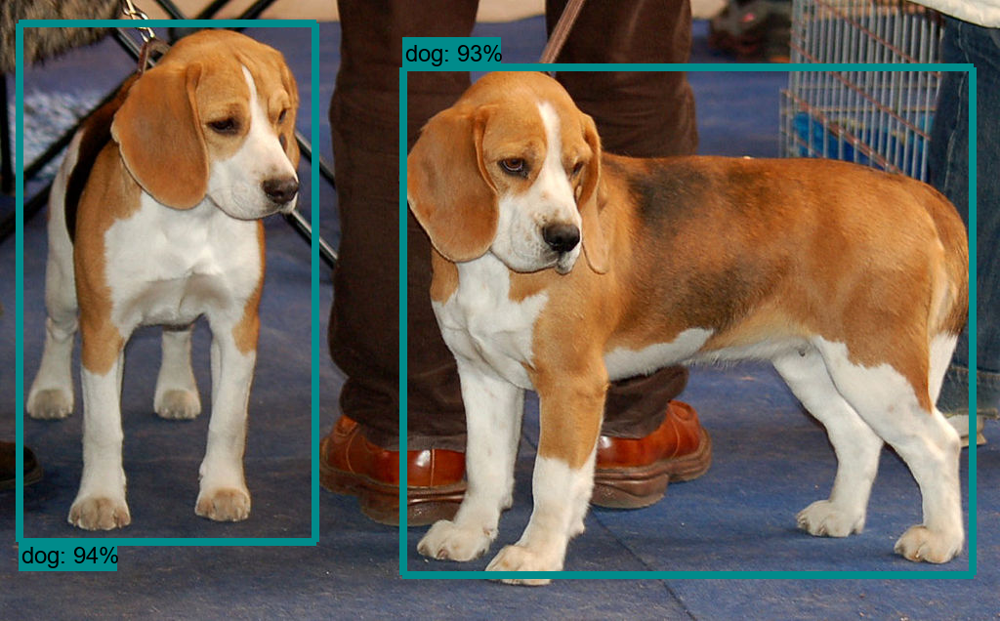

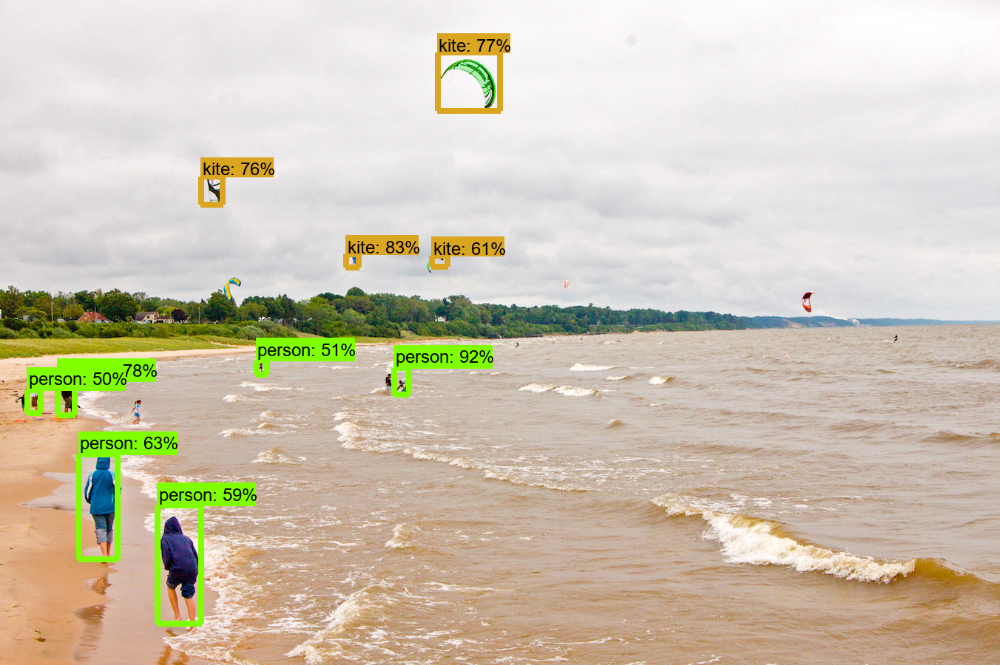

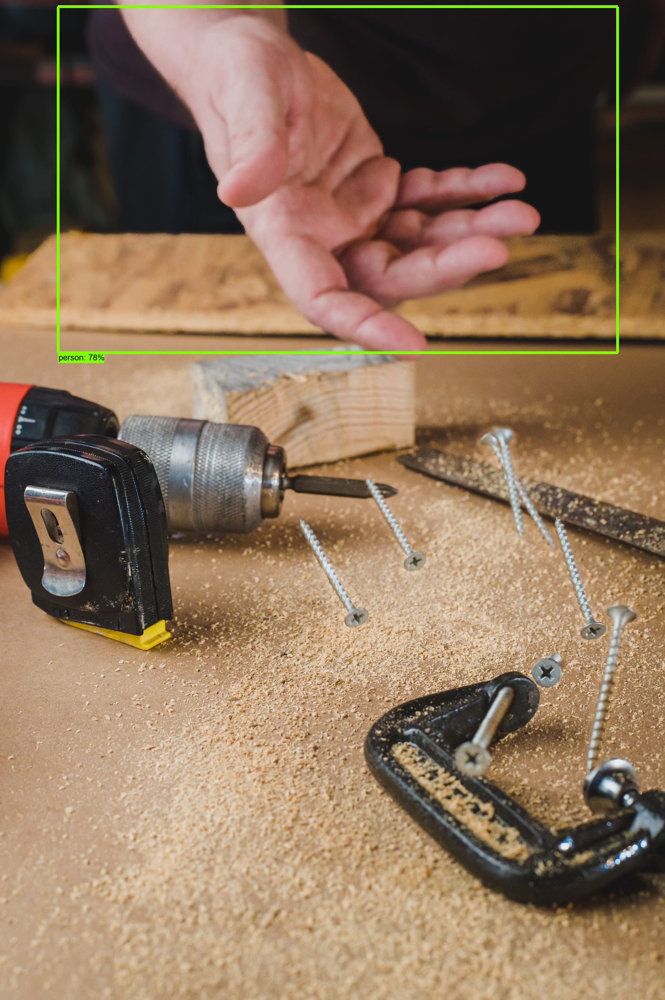

In [ ]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(detection_model, image_path)

In [ ]:
model_name = "mask_rcnn_inception_resnet_v2_atrous_coco_2018_01_28"
masking_model = load_model(model_name)

C:\Users\OMC\.keras\datasets\mask_rcnn_inception_resnet_v2_atrous_coco_2018_01_28\mask_rcnn_inception_resnet_v2_atrous_coco_2018_01_28\saved_model
INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


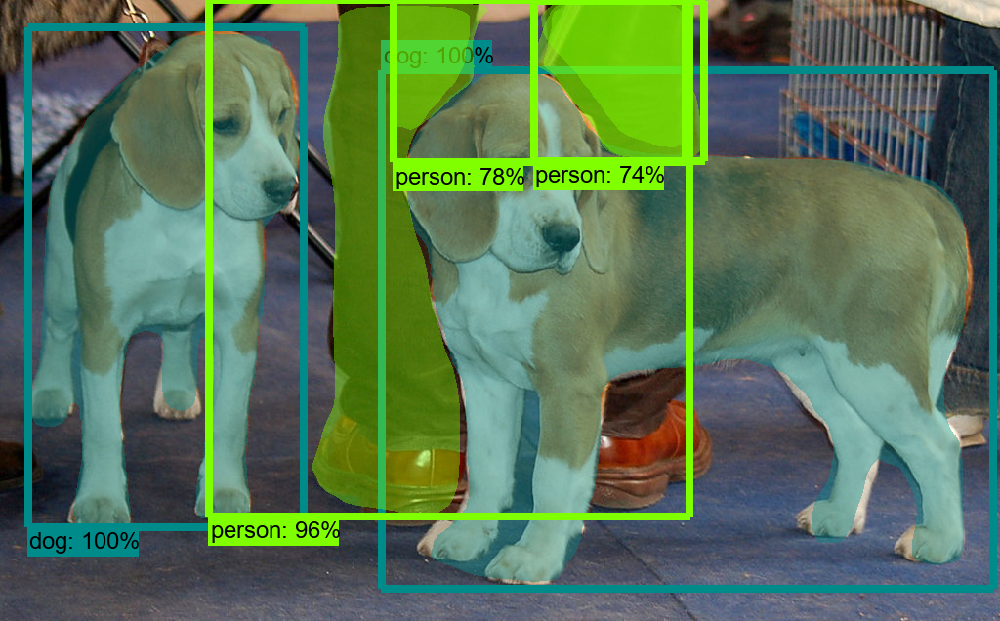

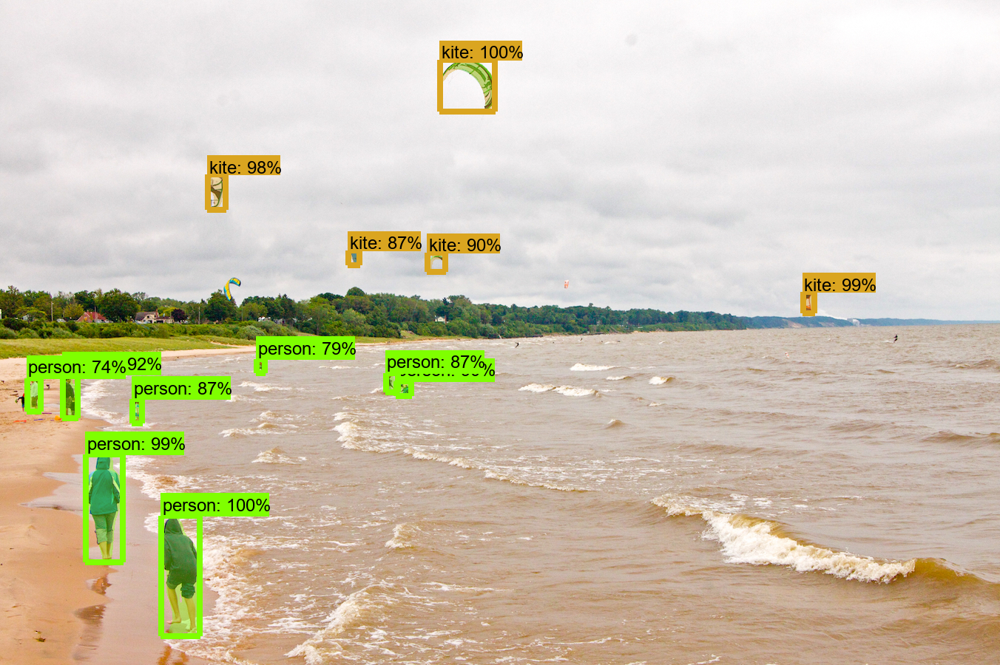

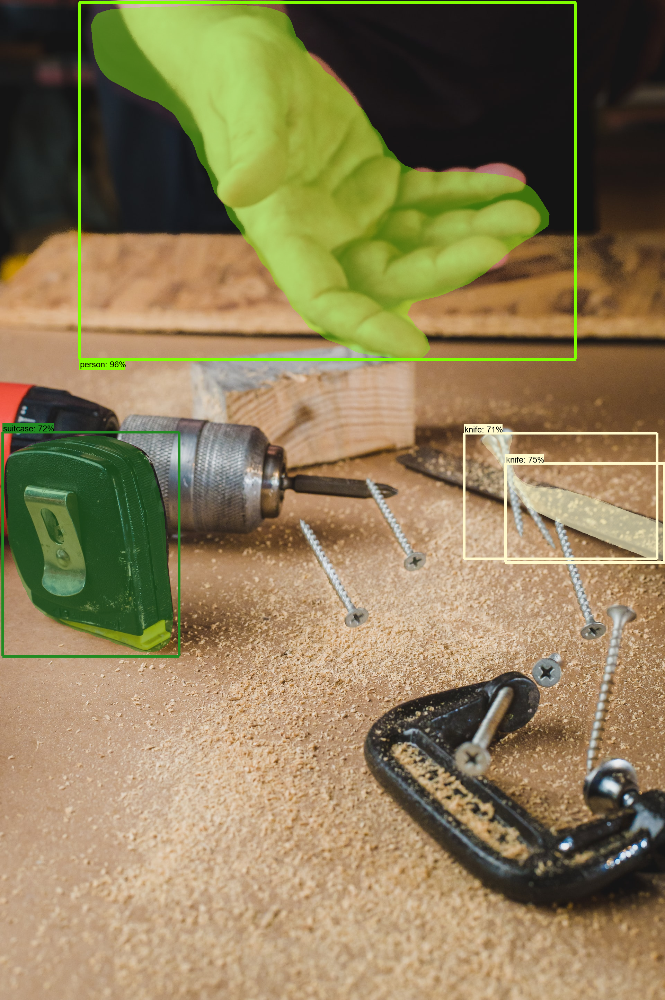

In [ ]:
for image_path in TEST_IMAGE_PATHS:
  show_inference(masking_model, image_path)

## Problema 3: Aprendiendo Iris (Clasificación binaria) con keras

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# Loading dataset
dfI = pd.read_csv("data/Iris.csv")

# Preprocess
df = dfI[dfI['Species'].isin(['Iris-versicolor', 'Iris-virginica'])]
X = df[['SepalLengthCm', 'SepalWidthCm', 'PetalLengthCm', 'PetalWidthCm']].values
y = (df['Species'] == 'Iris-virginica').astype(int).values

# Splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Building model
model = Sequential([
    Dense(10, activation='relu', input_shape=(4, )),
    Dense(1, activation='sigmoid')
])

# Compiling and training
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=50, validation_split=0.1)
model.evaluate(X_test, y_test)

Epoch 1/50


c:\Users\OMC\Documents\ProjectDetection\pythonvision\Lib\site-packages\keras\src\layers\core\dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


3/3 ━━━━━━━━━━━━━━━━━━━━ 1s 66ms/step - accuracy: 0.5000 - loss: 1.0160 - val_accuracy: 0.5000 - val_loss: 0.9617
Epoch 2/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.5000 - loss: 0.9742 - val_accuracy: 0.5000 - val_loss: 0.9241
Epoch 3/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.5000 - loss: 0.9391 - val_accuracy: 0.5000 - val_loss: 0.8884
Epoch 4/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.5000 - loss: 0.8998 - val_accuracy: 0.5000 - val_loss: 0.8552
Epoch 5/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - accuracy: 0.5000 - loss: 0.8674 - val_accuracy: 0.5000 - val_loss: 0.8238
Epoch 6/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.5000 - loss: 0.8369 - val_accuracy: 0.5000 - val_loss: 0.7951
Epoch 7/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.5000 - loss: 0.8061 - val_accuracy: 0.5000 - val_loss: 0.7695
Epoch 8/50
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - accuracy: 0.5000 - loss: 0.7798 - val_accuracy: 0.5000 - val_loss: 0.7462
Epoch 9/50


[0.6417717933654785, 0.6499999761581421]

## Problema 4: Aprendiendo Iris (clasificación múltiple) con keras

In [ ]:
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical

#

X = dfI[['SepalLengthCm', 'SepalWidthCm', 'PetalLengthCm', 'PetalWidthCm']].values
y = dfI['Species'].values

#encoding classes to integers then one-hot
le = LabelEncoder()
y = le.fit_transform(y)
y = to_categorical(y)
# Splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Building model
model = Sequential([
    Dense(16, activation='relu', input_shape=(4, )),
    Dense(3, activation='softmax')
])

# Compiling and training
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=50, validation_split=0.1)
model.evaluate(X_test, y_test)

Epoch 1/50


c:\Users\OMC\Documents\ProjectDetection\pythonvision\Lib\site-packages\keras\src\layers\core\dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - accuracy: 0.4167 - loss: 0.8413 - val_accuracy: 0.1667 - val_loss: 0.9192
Epoch 2/50
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.3981 - loss: 0.8124 - val_accuracy: 0.2500 - val_loss: 0.8901
Epoch 3/50
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.4722 - loss: 0.7862 - val_accuracy: 0.4167 - val_loss: 0.8628
Epoch 4/50
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.6111 - loss: 0.7670 - val_accuracy: 0.5833 - val_loss: 0.8436
Epoch 5/50
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step - accuracy: 0.7037 - loss: 0.7454 - val_accuracy: 0.5833 - val_loss: 0.8191
Epoch 6/50
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.7037 - loss: 0.7278 - val_accuracy: 0.5833 - val_loss: 0.8001
Epoch 7/50
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - accuracy: 0.7037 - loss: 0.7117 - val_accuracy: 0.5833 - val_loss: 0.7808
Epoch 8/50
4/4 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step - accuracy: 0.7037 - loss: 0.6978 - val_accuracy: 0.5833 - val_loss: 0.7648
Epoch 9/50


[0.496512770652771, 0.6000000238418579]

## Problema 5: Aprendiendo House Price con keras

In [ ]:
df = pd.read_csv('data/train.csv')
df = df[['GrLivArea', 'YearBuilt', 'SalePrice']]

X = df[['GrLivArea', 'YearBuilt']].values
y = df['SalePrice'].values

# Normalizing inputs
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = scaler.fit_transform(X)

# training-test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Building model
model = Sequential([
    Dense(64, activation='relu', input_shape=(2, )),
    Dense(1)
])

# Compiling and training
model.compile(optimizer='adam', loss='mse', metrics=['mae'])
model.fit(X_train, y_train, epochs=100, validation_split=0.1)
model.evaluate(X_test, y_test)

Epoch 1/100


c:\Users\OMC\Documents\ProjectDetection\pythonvision\Lib\site-packages\keras\src\layers\core\dense.py:92: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


33/33 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - loss: 39351468032.0000 - mae: 181726.2969 - val_loss: 34332332032.0000 - val_mae: 172564.5312
Epoch 2/100
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 39351246848.0000 - mae: 181725.7500 - val_loss: 34332125184.0000 - val_mae: 172563.9688
Epoch 3/100
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 39350996992.0000 - mae: 181725.0469 - val_loss: 34331869184.0000 - val_mae: 172563.2500
Epoch 4/100
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 39350681600.0000 - mae: 181724.2188 - val_loss: 34331549696.0000 - val_mae: 172562.3594
Epoch 5/100
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 39350280192.0000 - mae: 181723.2031 - val_loss: 34331158528.0000 - val_mae: 172561.2969
Epoch 6/100
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 39349796864.0000 - mae: 181721.9688 - val_loss: 34330679296.0000 - val_mae: 172560.0000
Epoch 7/100
33/33 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - loss: 39349202944.0000 - mae: 181720.5000 - val_loss: 34330089472.0000 - val_

[39253385216.0, 180185.828125]

## Problema 6: Mnist con Keras

In [ ]:
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Dropout, Flatten
from tensorflow.keras.datasets import mnist
# Loading
(X_train, y_train), (X_test, y_test) = mnist.load_data()

#preprocesing
X_train = X_train / 255.0
X_test = X_test / 255.0
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

#Building model
model = Sequential([
    Conv2D(24, kernel_size=3, padding='same', activation='relu', input_shape=(28, 28, 1)),
    MaxPooling2D(),
    Conv2D(48, kernel_size=3, padding='same', activation='relu'),
    MaxPooling2D(),
    Flatten(),
    Dense(10, activation='softmax')
])

# Compiling and training
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.fit(X_train, y_train, epochs=10, validation_split=0.1)
model.evaluate(X_test, y_test)

Epoch 1/10


c:\Users\OMC\Documents\ProjectDetection\pythonvision\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


1688/1688 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.9470 - loss: 0.1729 - val_accuracy: 0.9845 - val_loss: 0.0556
Epoch 2/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9819 - loss: 0.0600 - val_accuracy: 0.9867 - val_loss: 0.0446
Epoch 3/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9857 - loss: 0.0449 - val_accuracy: 0.9880 - val_loss: 0.0416
Epoch 4/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.9894 - loss: 0.0339 - val_accuracy: 0.9827 - val_loss: 0.0535
Epoch 5/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9913 - loss: 0.0278 - val_accuracy: 0.9893 - val_loss: 0.0391
Epoch 6/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9930 - loss: 0.0217 - val_accuracy: 0.9897 - val_loss: 0.0388
Epoch 7/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.9941 - loss: 0.0178 - val_accuracy: 0.9902 - val_loss: 0.0399
Epoch 8/10
1688/1688 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.9950 - loss: 0.0147 - val_accurac

[0.04396267235279083, 0.9882000088691711]

## Problema 7: Reescribir en pytorch

### Clasificación binaria de Iris

In [2]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torch.optim as optim

# Loading an preprocessing
dfI = pd.read_csv("data/Iris.csv")

df = dfI[dfI['Species'].isin(['Iris-versicolor', 'Iris-virginica'])]
X = df[['SepalLengthCm', 'SepalWidthCm', 'PetalLengthCm', 'PetalWidthCm']].values
y = (df['Species'] == 'Iris-virginica').astype(int).values

scaler = StandardScaler()
X = scaler.fit_transform(X)

# Splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

X_train, y_train = torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
X_test, y_test = torch.tensor(X_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.float32).unsqueeze(1)

# Model
model = nn.Sequential(
    nn.Linear(4, 10),
    nn.ReLU(),
    nn.Linear(10, 1),
    nn.Sigmoid()
)

criterion = nn.BCELoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

# Training loop
for epoch in range(50):
    model.train()
    y_pred = model(X_train)
    loss = criterion(y_pred, y_train)
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

# Evaluating
with torch.no_grad():
    model.eval()
    test_pred = model(X_test)
    acc = ((test_pred > 0.5) == y_test).float().mean()
    print(f'Test Accuracy: {acc.item():.4f}')

Test Accuracy: 0.9500


### clasificación multiclase de Iris con Pytorch

In [4]:
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import accuracy_score, max_error
#

X = dfI[['SepalLengthCm', 'SepalWidthCm', 'PetalLengthCm', 'PetalWidthCm']].values
y = dfI['Species'].values

#encoding classes to integers then one-hot
le = LabelEncoder()
y = le.fit_transform(y)

scaler = StandardScaler()
X = scaler.fit_transform(X)

# Splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

X_train, y_train = torch.tensor(X_train, dtype=torch.float32), torch.LongTensor(y_train)
X_test, y_test = torch.tensor(X_test, dtype=torch.float32), torch.LongTensor(y_test)
# Model
model = nn.Sequential(
    nn.Linear(4, 16),
    nn.ReLU(),
    nn.Linear(16, 3)
)

criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

# Training loop
for epoch in range(100):
    model.train()
    optimizer.zero_grad()
    y_pred = model(X_train)
    loss = criterion(y_pred, y_train)
    loss.backward()
    optimizer.step()

# Evaluating
with torch.no_grad():
    model.eval()
    test_pred = model(X_test)

    _, predicted = torch.max(test_pred, 1)
    acc = accuracy_score(y_test, predicted)
    print(f'Test Accuracy: {acc}')

Test Accuracy: 1.0


### house price con pytorch

In [5]:
df = pd.read_csv('data/train.csv')
df = df[['GrLivArea', 'YearBuilt', 'SalePrice']]

X = df[['GrLivArea', 'YearBuilt']].values
y = df['SalePrice'].values

# Normalizing inputs
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X = scaler.fit_transform(X)

# training-test splitting
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# X_train, y_train = torch.tensor(X_train, dtype=torch.float32), torch.LongTensor(y_train)
# X_test, y_test = torch.tensor(X_test, dtype=torch.float32), torch.LongTensor(y_test)

X_train, y_train = torch.tensor(X_train, dtype=torch.float32), torch.tensor(y_train, dtype=torch.float32).unsqueeze(1)
X_test, y_test = torch.tensor(X_test, dtype=torch.float32), torch.tensor(y_test, dtype=torch.float32).unsqueeze(1)

# Model
model = nn.Sequential(
    nn.Linear(2, 64),
    nn.ReLU(),
    nn.Linear(64, 1)
)

criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.01)

# Training loop
for epoch in range(100):
    model.train()
    optimizer.zero_grad()
    y_pred = model(X_train)
    loss = criterion(y_pred, y_train)
    loss.backward()
    optimizer.step()

# Evaluating
with torch.no_grad():
    model.eval()
    test_pred = model(X_test)

    _, predicted = torch.max(test_pred, 1)
    acc = max_error(y_test, predicted)
    print(f'max error: {acc}, loss: {loss}')

max error: 745000.0, loss: 38801117184.0


### mnist cin pytorch

In [6]:
import torch
from torch import nn, optim
from torch.nn import functional as F
from torchvision import datasets, transforms

batch_size = 128
num_epochs = 2
#device = torch.device("cpu")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Dispositivo: {device}")

class Net(nn.Module):
    def __init__(self):
        super().__init__()

        self.conv_layers = nn.Sequential(
            nn.Conv2d(1, 10, kernel_size=5),
            nn.MaxPool2d(2),
            nn.ReLU(),
            nn.Conv2d(10, 20, kernel_size=5),
            nn.Dropout(),
            nn.MaxPool2d(2),
            nn.ReLU(),
        )
        self.fc_layers = nn.Sequential(
            nn.Linear(320, 50),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(50, 10),
            nn.Softmax(dim=1),
        )

    def forward(self, x):
        x = self.conv_layers(x)
        x = x.view(-1, 320)
        x = self.fc_layers(x)
        return x


def train(model, device, train_loader, optimizer):
    model.train()
    for batch_idx, (data, target) in enumerate(train_loader):
        data, target = data.to(device), target.to(device)
        optimizer.zero_grad()
        output = model(data)
        loss = F.nll_loss(output.log(), target)
        loss.backward()
        optimizer.step()


def test(model, device, test_loader):
    model.eval()
    test_loss = 0
    correct = 0
    with torch.no_grad():
        for data, target in test_loader:
            data, target = data.to(device), target.to(device)
            output = model(data)
            test_loss += F.nll_loss(output.log(), target).item()  # sum up batch loss
            pred = output.max(1, keepdim=True)[1]  # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()

    test_loss /= len(test_loader.dataset)
    print(
        f"\nTest set: Average loss: {test_loss:.4f},"
        f" Accuracy: {correct}/{len(test_loader.dataset)}"
        f" ({100.0 * correct / len(test_loader.dataset):.0f}%)\n"
    )


train_loader = torch.utils.data.DataLoader(
    datasets.MNIST(
        "mnist_data",
        train=True,
        download=True,
        transform=transforms.Compose([transforms.ToTensor()]),
    ),
    batch_size=batch_size,
    shuffle=True,
)

test_loader = torch.utils.data.DataLoader(
    datasets.MNIST("mnist_data", train=False, transform=transforms.Compose([transforms.ToTensor()])),
    batch_size=batch_size,
    shuffle=True,
)

model = Net().to(device)
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.5)

for epoch in range(1, num_epochs + 1):
    train(model, device, train_loader, optimizer)

test(model, device, test_loader)

Dispositivo: cpu


100%|██████████| 9.91M/9.91M [00:00<00:00, 38.5MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 1.09MB/s]
100%|██████████| 1.65M/1.65M [00:00<00:00, 9.41MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 7.21MB/s]



Test set: Average loss: 0.0024, Accuracy: 9419/10000 (94%)



## Problema 8: comparación de frameworks

**PyTorch** se destaca por varias razones:

- Gráfico de Computación Dinámica: Conocida como Autograd, esta función permite mayor flexibilidad en la construcción de redes neuronales. Se ajusta dinámicamente a los cambios y actualizaciones durante el proceso de aprendizaje.

- Naturaleza Python: PyTorch está profundamente integrado con Python, lo que lo hace intuitivo y accesible para los programadores. Aprovecha la simplicidad y la potencia de Python para que la experiencia de programación sea más natural.

- Amplias bibliotecas y herramientas: PyTorch proporciona un ecosistema integral para el aprendizaje profundo, incluidas bibliotecas para visión artificial (TorchVision) y procesamiento del lenguaje natural (TorchText).

- Compatibilidad con aceleración de GPU: como muchos marcos de IA modernos, PyTorch utiliza de manera eficiente la aceleración de hardware de GPU, lo que lo hace adecuado para la investigación y el entrenamiento de modelos de alto rendimiento.

- Fuerte apoyo de la comunidad y la industria: con el respaldo de Meta y una comunidad vibrante, PyTorch evoluciona continuamente con contribuciones de investigadores académicos y profesionales de la industria.

**TensorFlow** tiene varios atributos notables:

- Computación basada en grafos: TensorFlow funciona con un modelo de computación basado en grafos, lo que significa que las operaciones se representan como nodos en un grafo de flujos de datos. Este enfoque permite utilizar eficientemente los recursos de CPU y GPU.

- Escalabilidad : TensorFlow es conocido por su escalabilidad, capaz de ejecutarse tanto en escritorios como en sistemas distribuidos a gran escala.

- API versátil: TensorFlow ofrece múltiples niveles de abstracción, lo que lo hace adecuado tanto para principiantes (a través de API de alto nivel como Keras) como para expertos.

- TensorBoard : una herramienta única para la visualización, TensorBoard ayuda a comprender y depurar modelos.

- Amplia adopción y apoyo de la comunidad: como producto de Google, TensorFlow ha sido ampliamente adoptado en la industria y el mundo académico, beneficiándose de una gran comunidad de desarrolladores e investigadores.

